In [6]:
# import necessary libraries
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T
import torchvision
import torch
import numpy as np
import cv2
import random
import time
import os
import subprocess
import requests
import glob

<h1>Download Pretrained</h1>

In [7]:
model = torchvision.models.detection.maskrcnn_resnet50_fpn(
    weights=torchvision.models.detection.MaskRCNN_ResNet50_FPN_Weights.DEFAULT
)
_ = model.eval()

 # These are the classes that are available in the COCO-Dataset
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

COLORS = np.random.uniform(0, 255, size=(len(COCO_INSTANCE_CATEGORY_NAMES), 3))

<h1>Utilities</h1>

In [8]:
def random_color_masks(image, colors):
    r, g, b = np.zeros_like(image, dtype=np.uint8), np.zeros_like(image, dtype=np.uint8), np.zeros_like(image, dtype=np.uint8)
    r[image == 1], g[image== 1], b[image == 1] = colors[random.randint(0, len(colors) - 1)]
    return np.stack([r, g, b], axis=2)

def get_prediction(img_path, threshold):
    img = Image.open(img_path)
    img_tensor = T.ToTensor()(img)
    with torch.no_grad():
        pred = model([img_tensor])
    
    pred_data = pred[0]
    scores = pred_data['scores'].detach().cpu().numpy()
    labels = pred_data['labels'].detach().cpu().numpy()
    boxes = pred_data['boxes'].detach().cpu().numpy()
    masks = (pred_data['masks'] > 0.5).squeeze().detach().cpu().numpy()
    
    valid_indices = scores > threshold
    if not np.any(valid_indices):
        return [], [], []
    
    pred_boxes = [[(b[0], b[1]), (b[2], b[3])] for b in boxes[valid_indices]]
    pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in labels[valid_indices]]
    masks = masks[valid_indices]

    return masks, pred_boxes, pred_class

def instance_segmentation_api(img_path, threshold=0.5):
    masks, boxes, pred_cls = get_prediction(img_path, threshold)
    
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    rect_th = max(round(sum(img.shape) / 2 * 0.003), 2)
    text_th = max(rect_th - 1, 1)
    
    for i in range(len(masks)):
        p1, p2 = (int(boxes[i][0][0]), int(boxes[i][0][1])), (int(boxes[i][1][0]), int(boxes[i][1][1])), 
        rgb_mask = random_color_masks(masks[i], COLORS)
        img = cv2.addWeighted(img, 1, rgb_mask, 0.5, 0)
        color = COLORS[COCO_INSTANCE_CATEGORY_NAMES.index(pred_cls[i])]
        cv2.rectangle(img, p1, p2, color=color, thickness=rect_th)
        
        w, h = cv2.getTextSize(pred_cls[i], 0, fontScale=rect_th/3, thickness=text_th)[0]
        outside = p1[1] - h >= 3
        p2 = (p1[0] + w, p1[1] - h - 3) if outside else (p1[0] + w, p1[1] + h + 3)

        # Draw filled rectangle as background for the class label
        cv2.rectangle(img, p1, p2, color=color, thickness=-1, lineType=cv2.LINE_AA)

        # Overlay the object class label on the image
        cv2.putText(
            img,
            pred_cls[i],
            (p1[0], p1[1] - 5 if outside else p1[1] + h + 2),
            cv2.FONT_HERSHEY_SIMPLEX,
            rect_th / 3,
            (255, 255, 255),
            thickness=text_th + 1
        )
    
    plt.figure(figsize=(20, 17))
    plt.imshow(img)
    plt.axis("off")
    plt.show()
    
        

In [9]:
def download_file(url, save_name):
    if not os.path.exists(save_name):
        subprocess.run(['wget', url, '-O', save_name, '-q'])

In [10]:
# Create directory to donwload inference data.
inference_dir = 'inference_data'
os.makedirs(inference_dir, exist_ok=True)

<h1>Inference</h1>

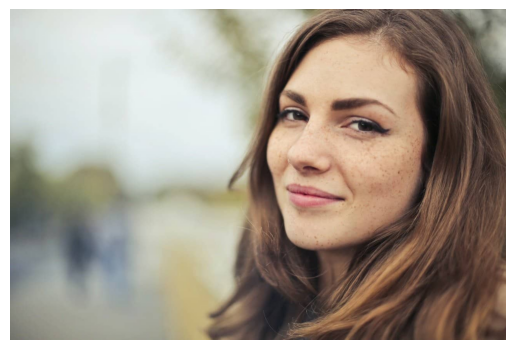

In [11]:
download_file(
    'https://learnopencv.com/wp-content/uploads/2022/10/person-1.jpg',
    os.path.join(inference_dir, 'person.jpg')
)
img = Image.open(os.path.join(inference_dir, 'person.jpg'))
plt.imshow(img)
plt.axis('off')
plt.show()


In [12]:
transform = T.Compose([T.ToTensor()])
img_tensor = transform(img)
with torch.no_grad():
    pred = model([img_tensor])
pred

[{'boxes': tensor([[ 431.6027,    2.4547, 1280.0001,  851.2909],
          [ 119.3286,   43.6908,  862.8626,  853.0000]]),
  'labels': tensor([1, 1]),
  'scores': tensor([0.9998, 0.1074]),
  'masks': tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0013, 0.0013, 0.0012],
            [0.0000, 0.0000, 0.0000,  ..., 0.0014, 0.0014, 0.0013],
            [0.0000, 0.0000, 0.0000,  ..., 0.0015, 0.0015, 0.0014],
            ...,
            [0.0000, 0.0000, 0.0000,  ..., 0.1385, 0.1310, 0.1234],
            [0.0000, 0.0000, 0.0000,  ..., 0.1301, 0.1230, 0.1159],
            [0.0000, 0.0000, 0.0000,  ..., 0.1216, 0.1150, 0.1083]]],
  
  
          [[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
            [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
            [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
            ...,
            [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
            [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
            

In [13]:
pred[0]

{'boxes': tensor([[ 431.6027,    2.4547, 1280.0001,  851.2909],
         [ 119.3286,   43.6908,  862.8626,  853.0000]]),
 'labels': tensor([1, 1]),
 'scores': tensor([0.9998, 0.1074]),
 'masks': tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0013, 0.0013, 0.0012],
           [0.0000, 0.0000, 0.0000,  ..., 0.0014, 0.0014, 0.0013],
           [0.0000, 0.0000, 0.0000,  ..., 0.0015, 0.0015, 0.0014],
           ...,
           [0.0000, 0.0000, 0.0000,  ..., 0.1385, 0.1310, 0.1234],
           [0.0000, 0.0000, 0.0000,  ..., 0.1301, 0.1230, 0.1159],
           [0.0000, 0.0000, 0.0000,  ..., 0.1216, 0.1150, 0.1083]]],
 
 
         [[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           ...,
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0

In [14]:
masks = (pred[0]['masks']>0.5).squeeze().detach().cpu().numpy()
masks.shape

(2, 853, 1280)

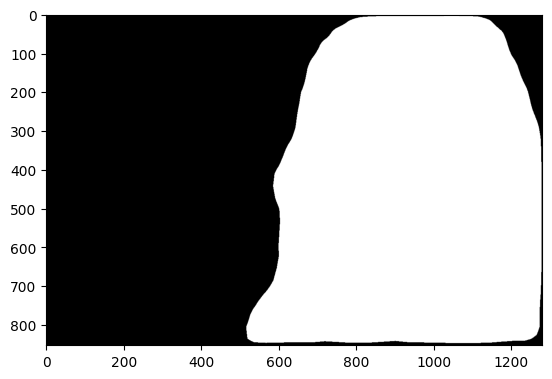

In [15]:
plt.imshow(masks[0], cmap='gray')
plt.show()

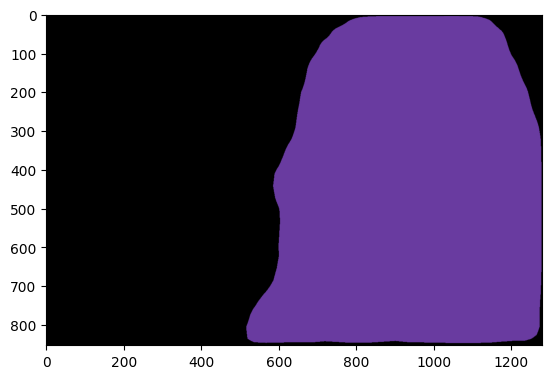

In [16]:
# Let's color the `person` mask using the `random_color_masks` function
mask1 = random_color_masks(masks[0], COLORS)
plt.imshow(mask1)
plt.show()

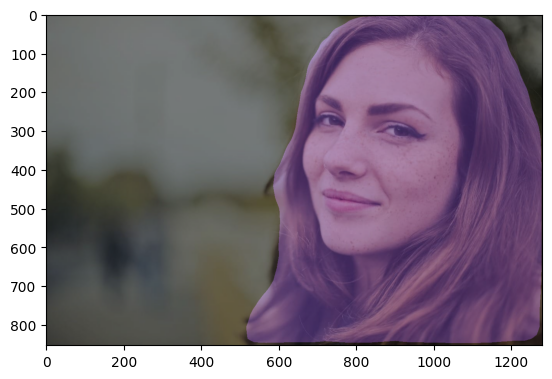

In [17]:
# Let's blend the original and the masked image and plot it.
blend_img = cv2.addWeighted(np.asarray(img), 0.5, mask1, 0.5, 0)

plt.imshow(blend_img)
plt.show()

<h1>Instance Segmentation</h1>

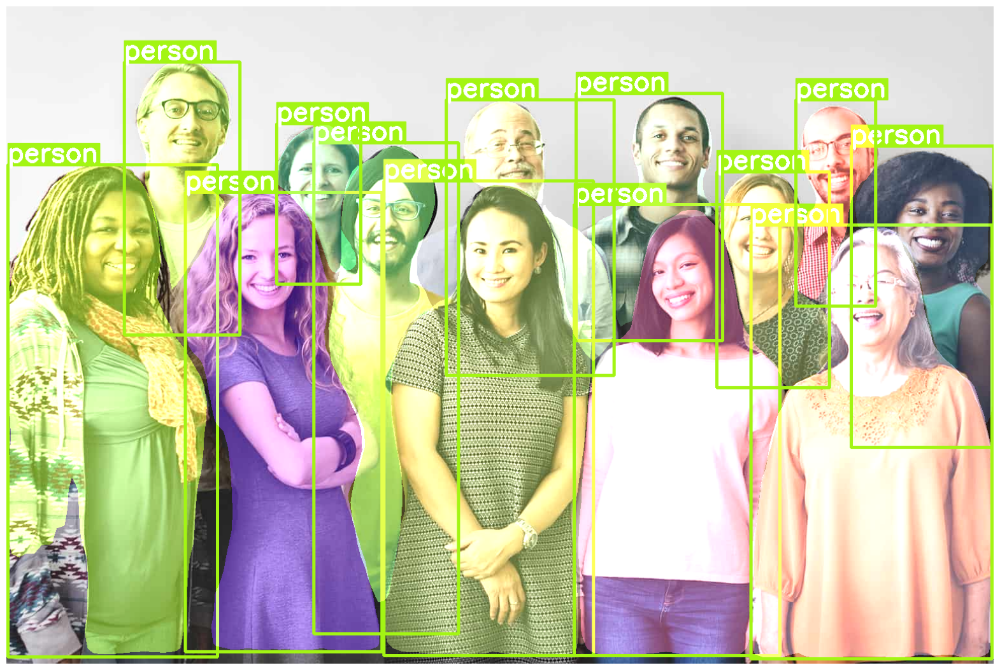

In [18]:
download_file(
    'https://learnopencv.com/wp-content/uploads/2022/10/mrcnn_standing_people.jpg',
    os.path.join(inference_dir, 'mrcnn_standing_people.jpg')
)
instance_segmentation_api(os.path.join(inference_dir, 'mrcnn_standing_people.jpg'), 0.75)

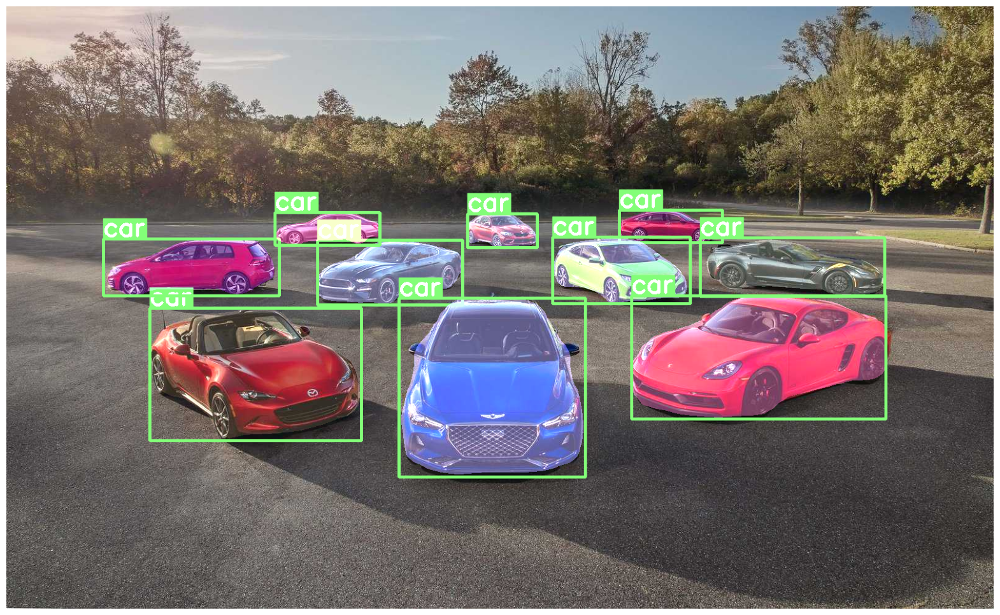

In [19]:
download_file(
    'https://learnopencv.com/wp-content/uploads/2022/10/mrcnn_cars-scaled.jpg',
    os.path.join(inference_dir, 'mrcnn_cars.jpg')
)
instance_segmentation_api(os.path.join(inference_dir, 'mrcnn_cars.jpg'), 0.9)

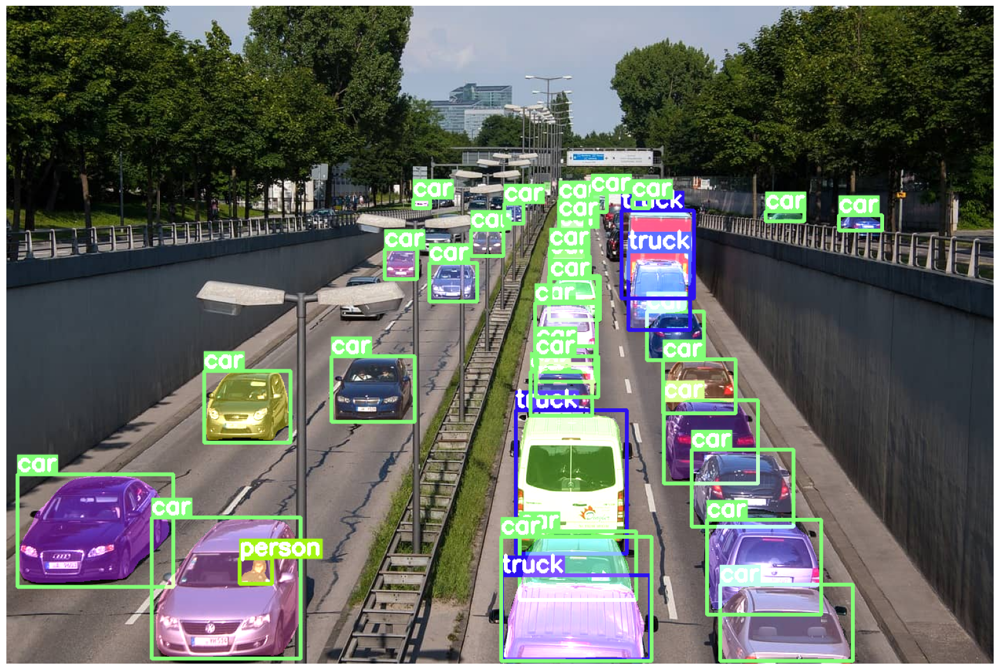

In [20]:
download_file(
    'https://learnopencv.com/wp-content/uploads/2022/10/mrcnn-traffic.jpg',
    os.path.join(inference_dir, 'mrcnn-traffic.jpg')
)
instance_segmentation_api(os.path.join(inference_dir, 'mrcnn-traffic.jpg'), 0.6)

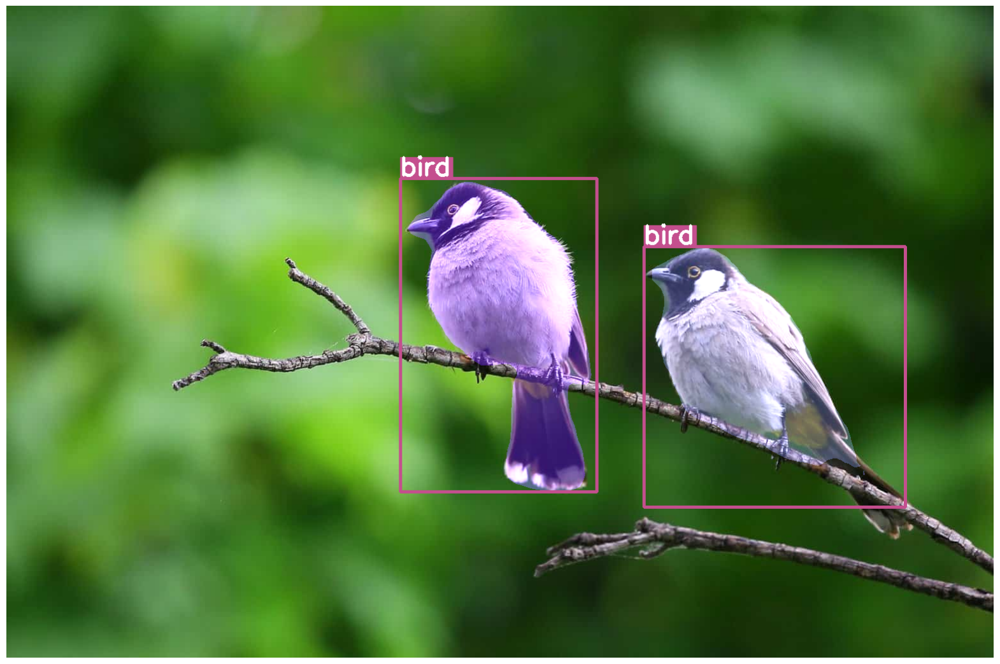

In [21]:
download_file(
    'https://learnopencv.com/wp-content/uploads/2022/10/mrcnn-birds.jpg',
    os.path.join(inference_dir, 'mrcnn-birds.jpg')
)
instance_segmentation_api(os.path.join(inference_dir, 'mrcnn-birds.jpg'), 0.9)

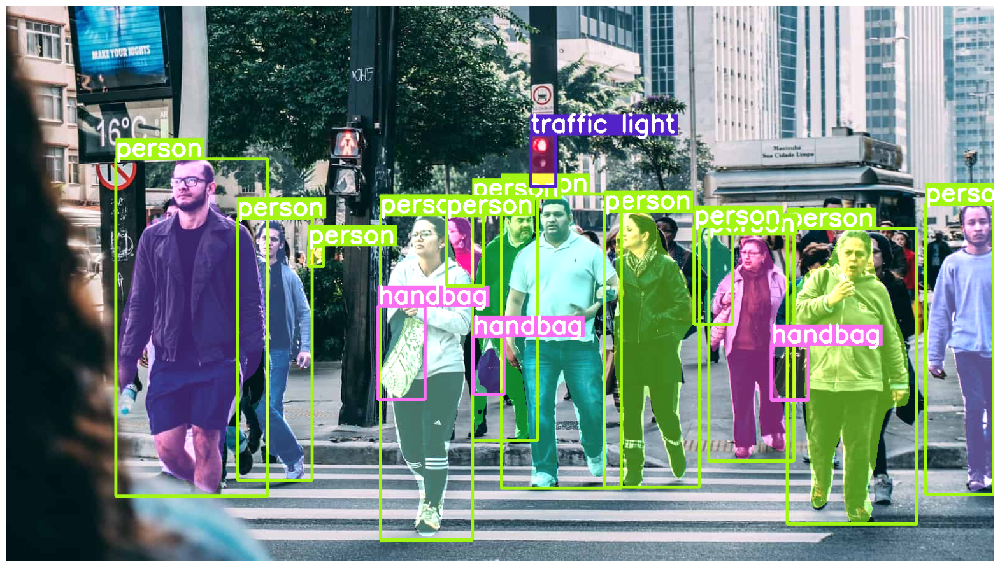

In [22]:
download_file(
    'https://learnopencv.com/wp-content/uploads/2022/10/mrcnn-crowd.jpg',
    os.path.join(inference_dir, 'mrcnn-crowd.jpg')
)
instance_segmentation_api(os.path.join(inference_dir, 'mrcnn-crowd.jpg'), 0.8)

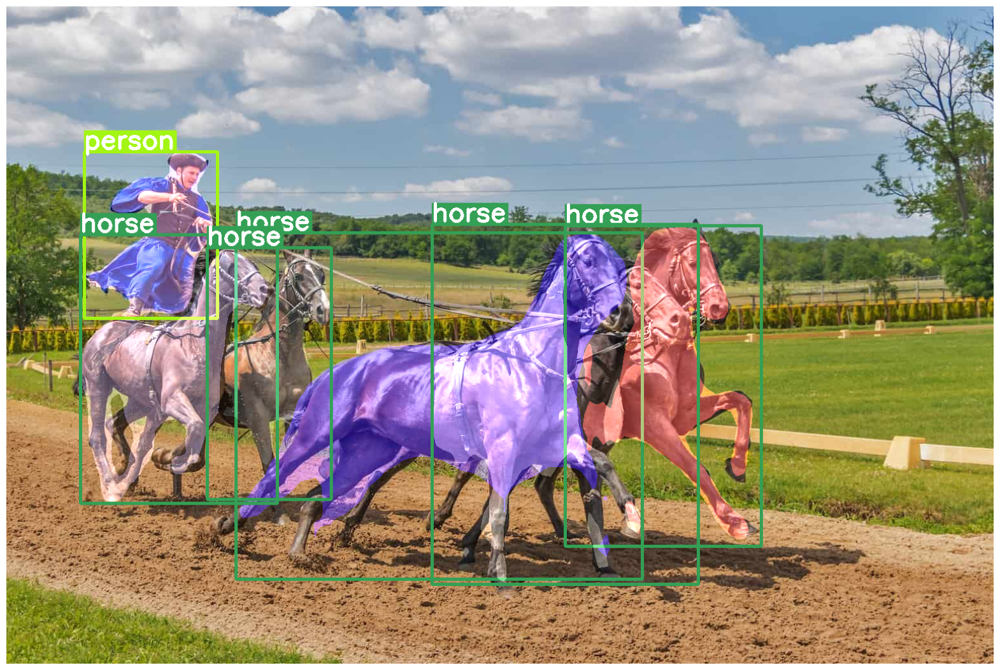

In [23]:
download_file(
    'https://learnopencv.com/wp-content/uploads/2022/10/mrcnn-horses.jpg',
    os.path.join(inference_dir, 'mrcnn-horses.jpg')
)
instance_segmentation_api(os.path.join(inference_dir, 'mrcnn-horses.jpg'), 0.8)

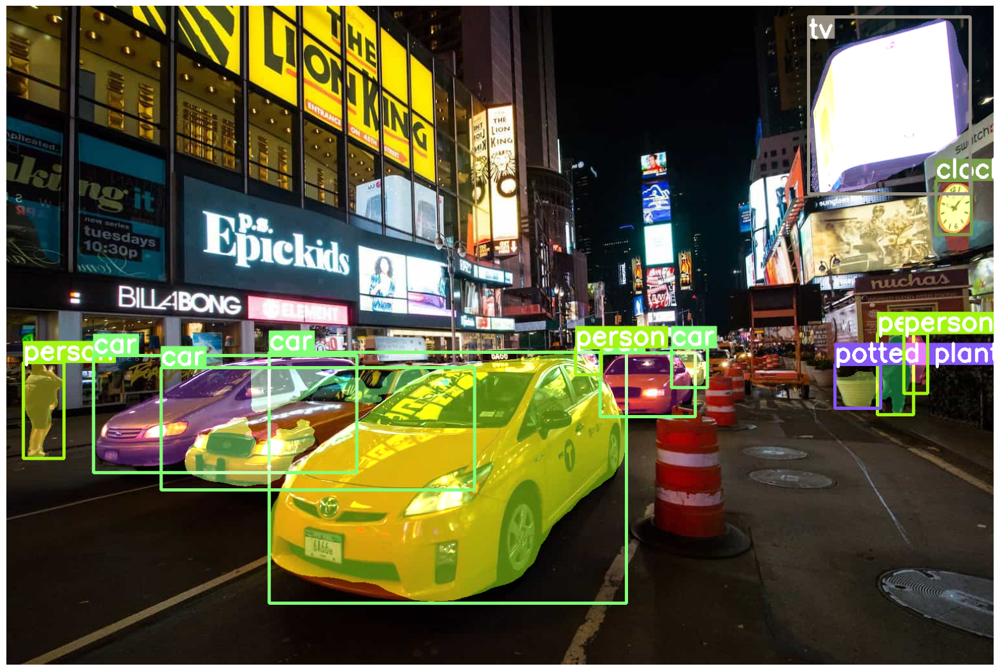

In [24]:
download_file(
    'https://learnopencv.com/wp-content/uploads/2022/10/mrcnn-low-light.jpg',
    os.path.join(inference_dir, 'mrcnn-low-light.jpg')
)
instance_segmentation_api(os.path.join(inference_dir, 'mrcnn-low-light.jpg'), 0.8)

In [25]:
# Load model
model = torchvision.models.detection.maskrcnn_resnet50_fpn(
    weights=torchvision.models.detection.MaskRCNN_ResNet50_FPN_Weights.DEFAULT
)
# Set model on evalution mode
model.eval()

import time

def check_inference_time(image_path, gpu=False):
    """
    Measures the inference time of a model on a given image.

    Parameters:
        image_path (str): Path to the input image.
        gpu (bool, optional): Whether to run inference on GPU. Defaults to False.

    Returns:
        float: Time taken for model inference in seconds.
    """

    # Load image and convert to a PyTorch tensor
    img = Image.open(image_path).convert("RGB")
    img = img.resize((800, 800))  # Resize to something reasonable
    img = T.ToTensor()(img).unsqueeze(0)

    # Move model and image to the selected device
    device = "cpu"
    if gpu and torch.backends.mps.is_available():
        print("run on mps")
        device = "mps"
    else:
        device = torch.device("cuda:0" if gpu and torch.cuda.is_available() else "cpu")
        
    model.to(device)
    model.eval()
    img = img.to(device)

    # Measure inference time
    start_time = time.time()
    with torch.no_grad():  # Disable gradient tracking for faster inference
        model(img)
    return time.time() - start_time  # Return elapsed time


In [26]:
# Let's run inference on all the downloaded images and average their inference time
img_paths = [
    path for path in glob.glob(os.path.join(inference_dir, '*')) \
    if path.split('.')[-1].lower() in ["jpeg", "jpg", "png"]
]

# gpu_times = []
# for img_path in img_paths:
#     gpu_time = check_inference_time(img_path, gpu=True)
#     gpu_times.append(gpu_time)

# gpu_time = sum([check_inference_time(img_path, gpu=True) for img_path in img_paths])/len(img_paths)
gpu_time = 0
cpu_time = sum([check_inference_time(img_path, gpu=False) for img_path in img_paths])/len(img_paths)

print('\n\nAverage Time take by the model with GPU = {}s\nAverage Time take by the model with CPU = {}s'.format(gpu_time, cpu_time))



Average Time take by the model with GPU = 0s
Average Time take by the model with CPU = 0.7398241758346558s


<h1>Application: Background Blurring</h1>

In [27]:
def pick_person_mask(img_path, threshold=0.5, rect_th=3, text_size=3, text_th=3):
    # get the predicted masks and boxes and their corresponding labels
    masks, boxes, pred_cls = get_prediction(img_path, threshold)
    # pick the indices belonging to person
    person_ids = [i for i in range(len(pred_cls)) if pred_cls[i]=="person"]
    # pick the masks with the person-ids
    person_masks = masks[person_ids, :, :]
    # create a single mask out of all the instances and clip them
    persons_mask = person_masks.sum(axis=0)
    persons_mask = np.clip(persons_mask, 0,1)
    return persons_mask

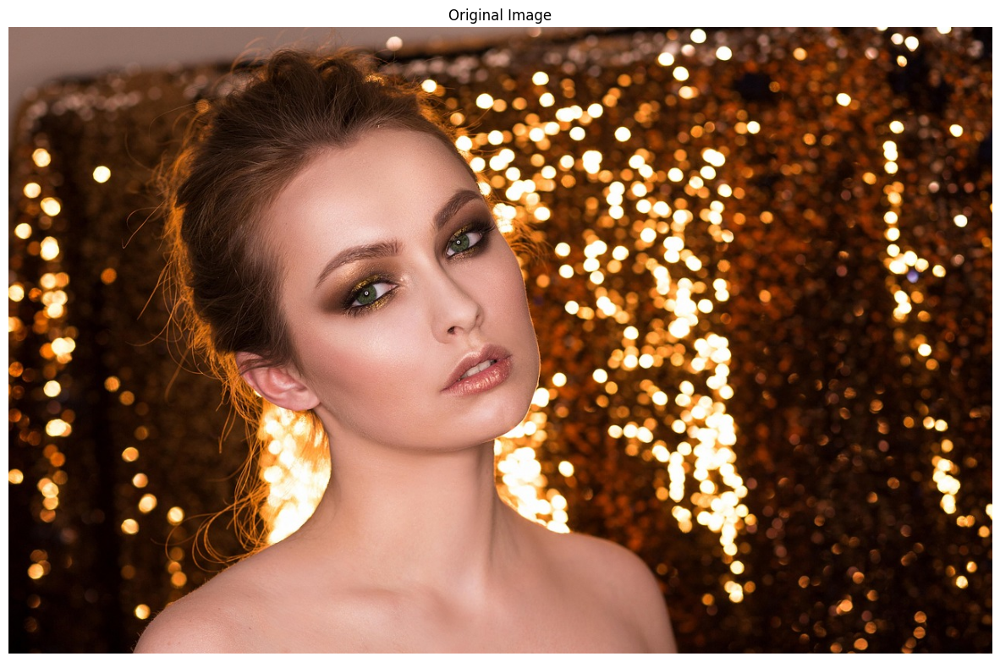

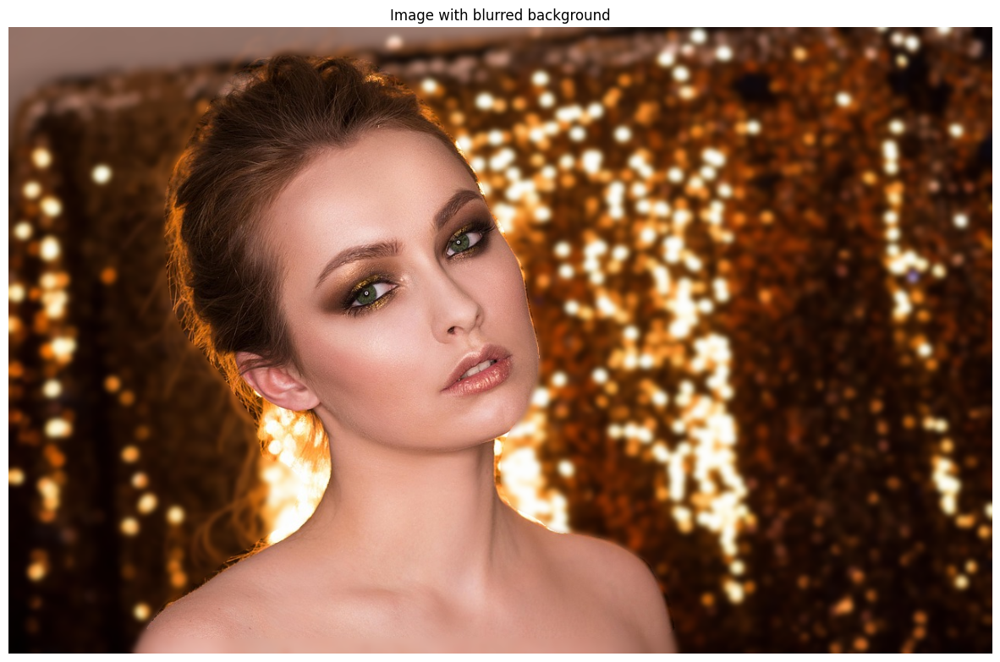

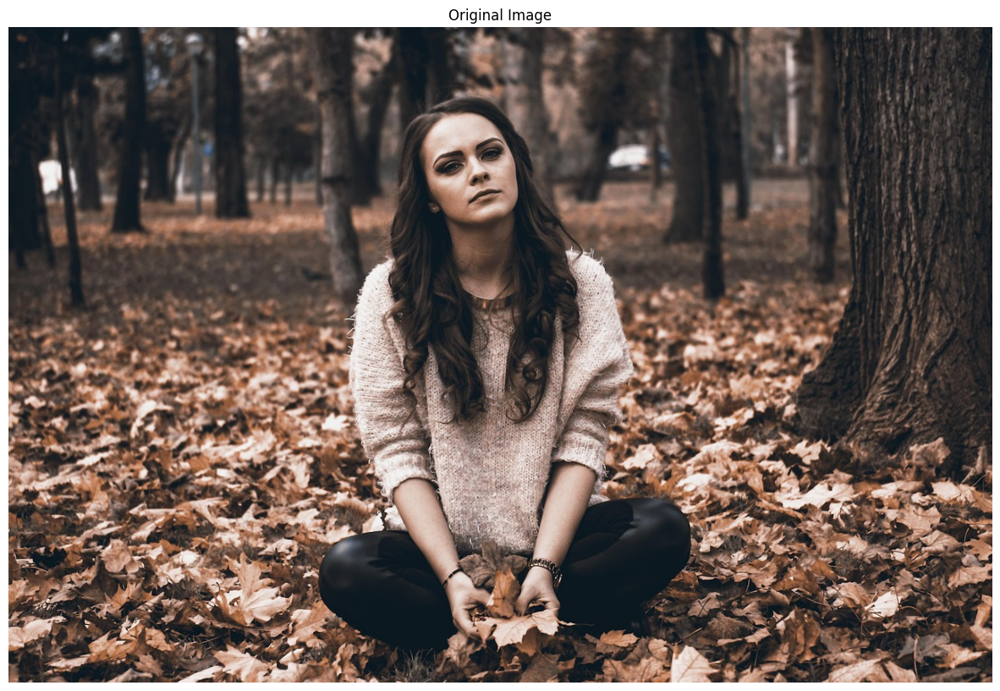

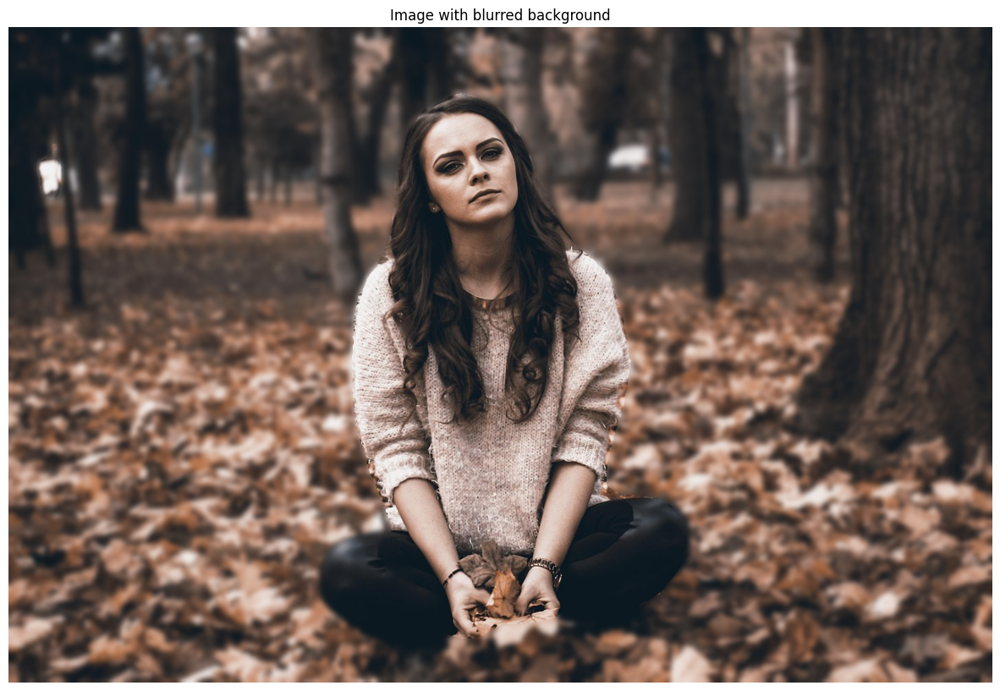

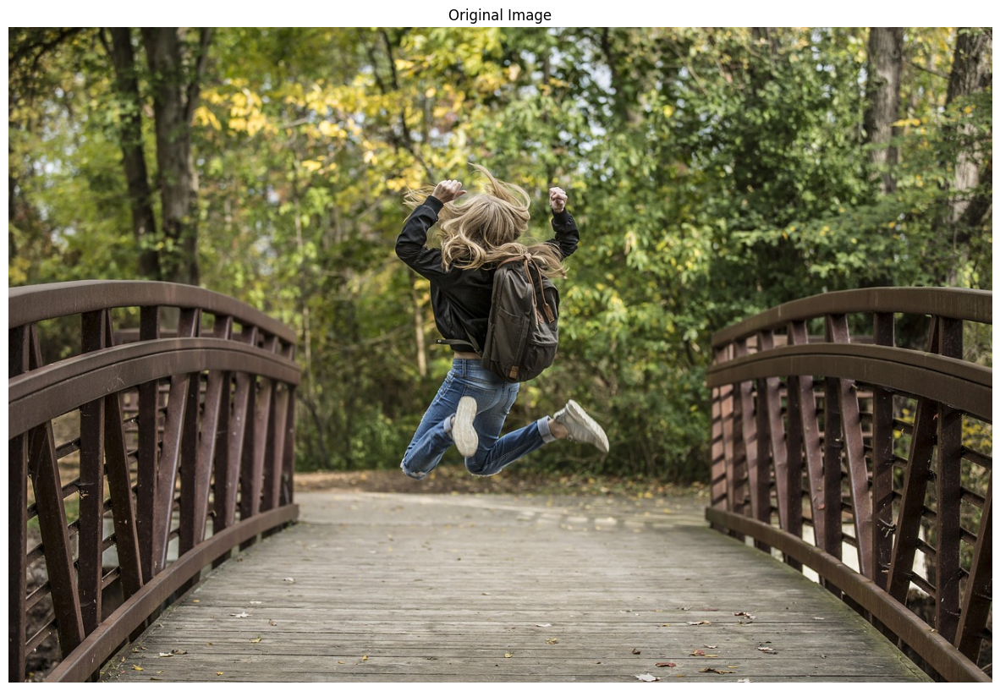

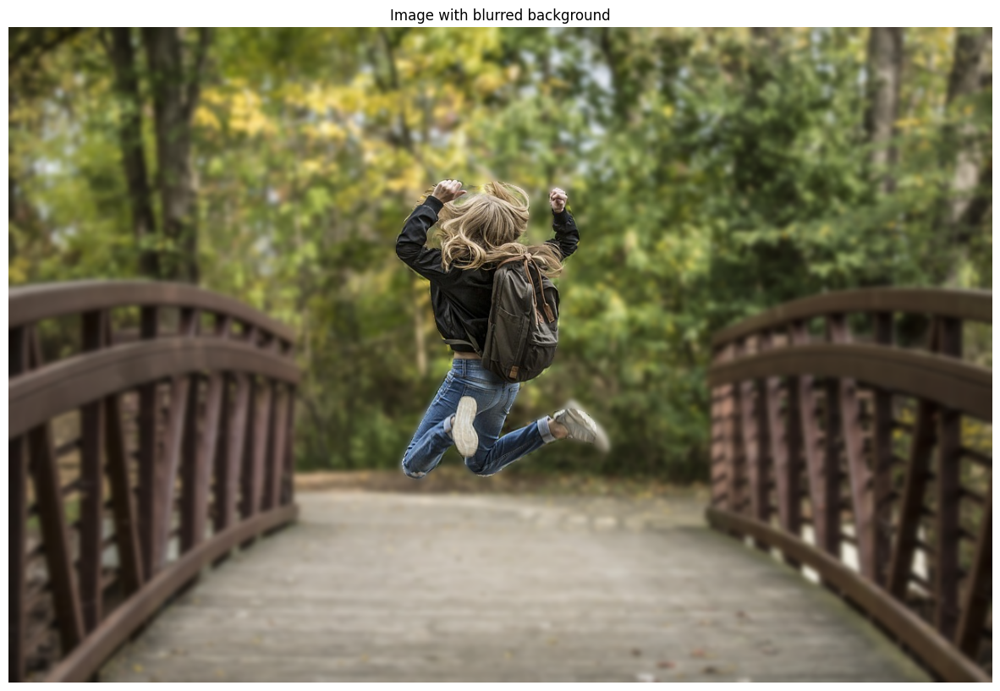

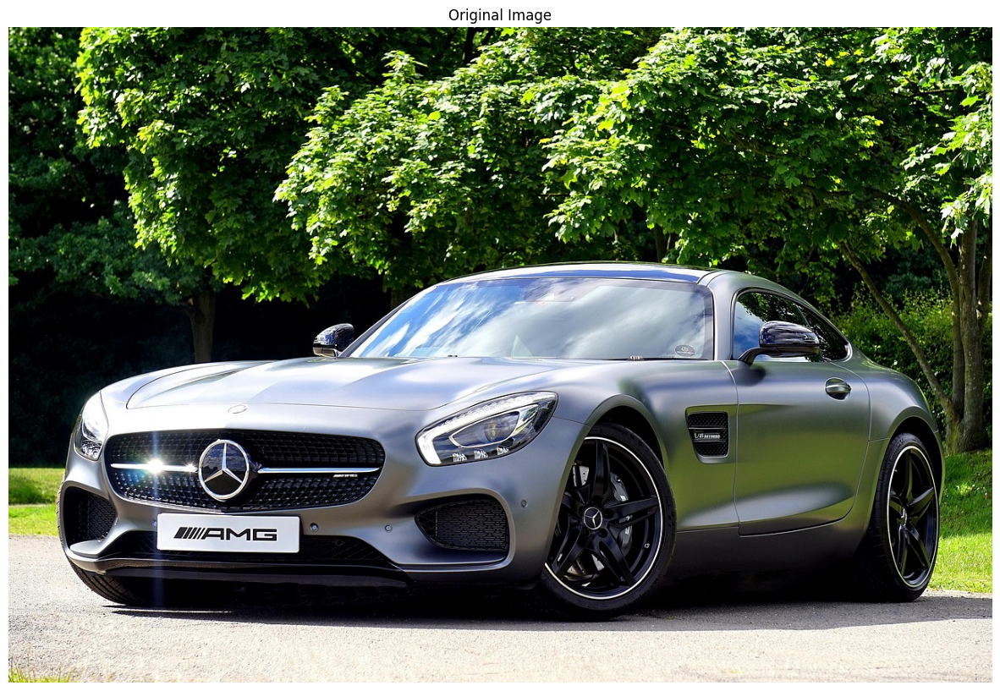

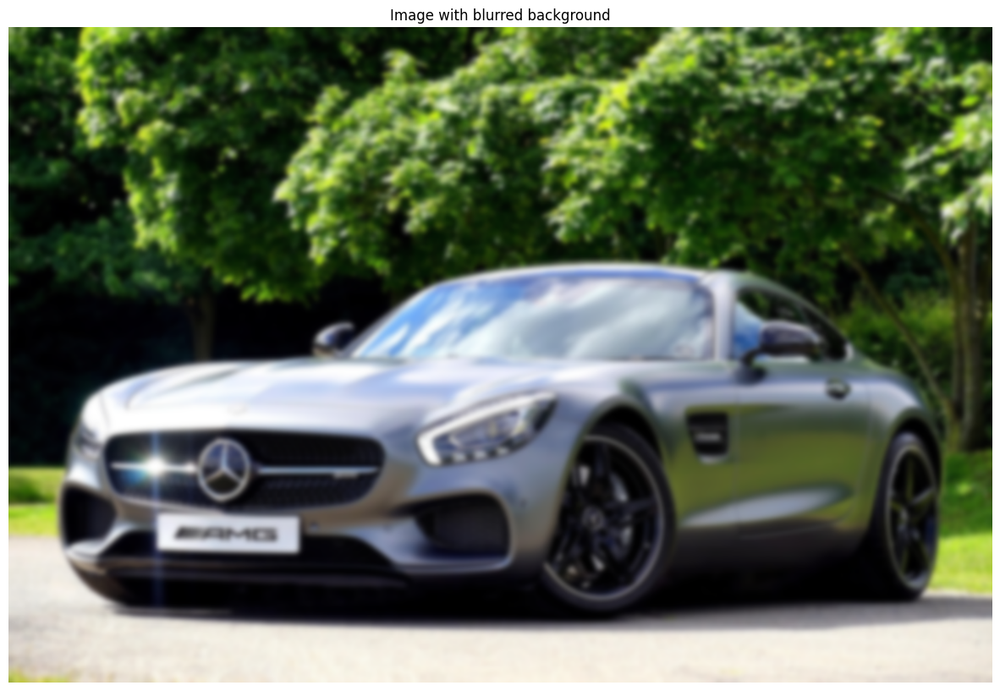

In [32]:
# These are a few images you can play around with
image_urls = [
    "https://cdn.pixabay.com/photo/2018/03/12/20/57/woman-3220835_1280.jpg",
    "https://cdn.pixabay.com/photo/2017/02/06/10/54/sad-2042536_1280.jpg",
    "https://cdn.pixabay.com/photo/2016/11/29/09/49/blond-1868815_1280.jpg",
    "https://cdn.pixabay.com/photo/2017/03/27/14/56/auto-2179220_1280.jpg",
]



def blurring(image_url):
    file_name = image_url.split("/")[-1]
    download_file(
        image_url,
        inference_dir + f"/{file_name}"
    )

    # grab the image and blur it
    img_path = inference_dir + f"/{file_name}"
    img = cv2.imread(img_path)
    img_blur = cv2.GaussianBlur(img, (21, 21), 0)

    # create the person-mask
    person_mask = pick_person_mask(img_path, threshold=0.2, rect_th=3, text_size=3, text_th=3).astype(np.uint8)
    person_mask = np.repeat(person_mask[:, :, None], 3, axis=2)

    # finally, create a new image such that pixels where the mask=1, replace it with original image and keep the rest of the pixels
    # with blurred image
    final_img = np.where(person_mask==1, img, img_blur)

    plt.figure(figsize=(15, 12))
    # plt.subplot(121)
    plt.imshow(img[:,:,::-1])
    plt.title('Original Image')
    plt.axis('off')
    plt.show()
    # plt.subplot(122)
    plt.figure(figsize=(15, 12))
    plt.imshow(final_img[:,:,::-1])
    plt.title('Image with blurred background')
    plt.axis('off')
    plt.show()

for image_url in image_urls:
    blurring(image_url)